In [0]:
!git clone https://github.com/Maosef/498L_Final_Project.git
import os
os.chdir('/content/498L_Final_Project')

Cloning into '498L_Final_Project'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 1393 (delta 0), reused 1 (delta 0), pack-reused 1390
Receiving objects: 100% (1393/1393), 324.94 MiB | 15.04 MiB/s, done.
Resolving deltas: 100% (3/3), done.


In [0]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torchvision
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [0]:
# Root directory for dataset
path = "/content/498L_Final_Project"
# dataroot = "data/celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 32

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 32

# Size of feature maps in discriminator
ndf = 32

# Number of training epochs
num_epochs = 480

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# model name
model_name = 'SSBU_Spirits_No_BatchNorm'

In [0]:
def load_dataset(path, batch_size, shuffle=True):
    dataset = torchvision.datasets.ImageFolder(
        root=path,
        transform=torchvision.transforms.Compose([
            torchvision.transforms.Resize((32,32)),
            torchvision.transforms.ToTensor()
        ])
    )

    loader = torch.utils.data.DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=shuffle
    )

    return loader

In [0]:
dataloader = load_dataset(path, batch_size)

In [0]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

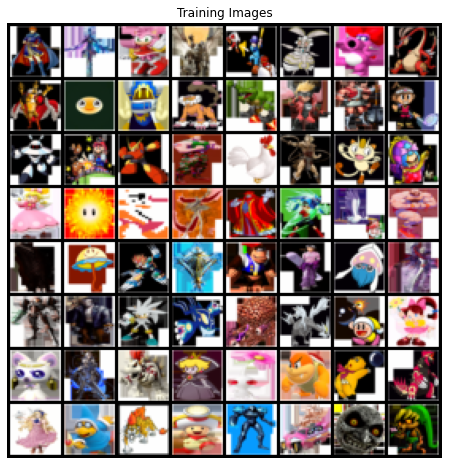

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [0]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, nc, 4, 2, 1, bias=False),
            # nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ngf),
            # nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            # nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [0]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            # nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            # nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            # nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [0]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)



# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): ReLU(inplace=True)
    (2): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): ReLU(inplace=True)
    (4): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): Tanh()
  )
)
Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 1, kernel_s

In [0]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [0]:
# tensorboard
from torch.utils.tensorboard import SummaryWriter

%load_ext tensorboard
%tensorboard --logdir=tb_log/SSBU_Spirits_No_BatchNorm # make sure to cd into the right place before


<IPython.core.display.Javascript object>

Starting Training Loop...


/pytorch/aten/src/ATen/native/TensorFactories.cpp:361: UserWarning: Deprecation warning: In a future PyTorch release torch.full will no longer return tensors of floating dtype by default. Instead, a bool fill_value will return a tensor of torch.bool dtype, and an integral fill_value will return a tensor of torch.long dtype. Set the optional `dtype` or `out` arguments to suppress this warning.


[0/480][0/11]	Loss_D: 1.3877	Loss_G: 0.6931	D(x): 0.4993	D(G(z)): 0.5000 / 0.5000


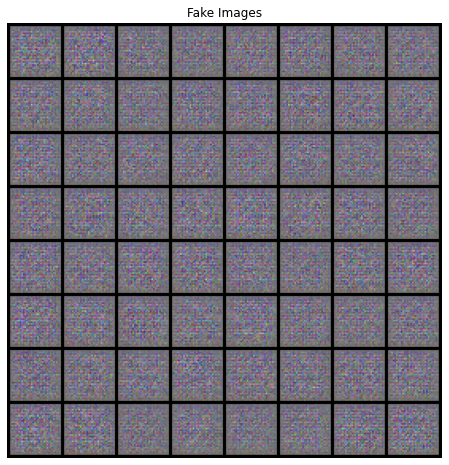

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


time (s):  18.66777491569519
[1/480][0/11]	Loss_D: 1.2574	Loss_G: 0.4872	D(x): 0.7267	D(G(z)): 0.6070 / 0.6144
time (s):  11.814801454544067
[2/480][0/11]	Loss_D: 1.3414	Loss_G: 0.7567	D(x): 0.5095	D(G(z)): 0.4867 / 0.4692
time (s):  11.779205560684204
[3/480][0/11]	Loss_D: 1.3130	Loss_G: 0.7173	D(x): 0.5136	D(G(z)): 0.4751 / 0.4880
time (s):  11.831271171569824
[4/480][0/11]	Loss_D: 1.2224	Loss_G: 0.7152	D(x): 0.5723	D(G(z)): 0.4801 / 0.4891
time (s):  11.748475313186646
[5/480][0/11]	Loss_D: 1.3777	Loss_G: 0.5602	D(x): 0.6021	D(G(z)): 0.5776 / 0.5711
time (s):  11.730780839920044
[6/480][0/11]	Loss_D: 1.2338	Loss_G: 0.7497	D(x): 0.6085	D(G(z)): 0.5181 / 0.4731
time (s):  11.786793231964111
[7/480][0/11]	Loss_D: 1.2590	Loss_G: 0.8627	D(x): 0.5848	D(G(z)): 0.5093 / 0.4224
time (s):  11.92215871810913
[8/480][0/11]	Loss_D: 1.2837	Loss_G: 0.5991	D(x): 0.6267	D(G(z)): 0.5555 / 0.5494
time (s):  11.741021394729614
[9/480][0/11]	Loss_D: 1.4078	Loss_G: 0.6008	D(x): 0.5790	D(G(z)): 0.5743 / 0

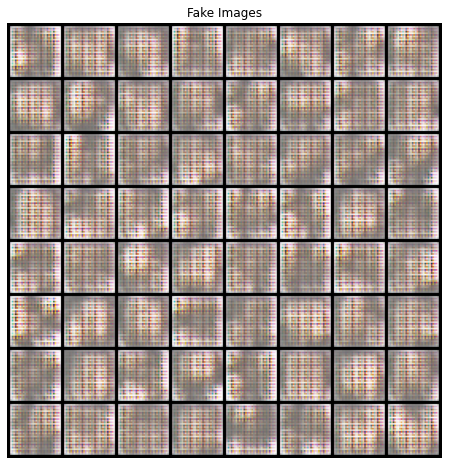

time (s):  11.965867757797241
[46/480][0/11]	Loss_D: 1.3483	Loss_G: 0.6821	D(x): 0.6379	D(G(z)): 0.5870 / 0.5073
time (s):  11.770551204681396
[47/480][0/11]	Loss_D: 1.2464	Loss_G: 0.6417	D(x): 0.5685	D(G(z)): 0.4890 / 0.5278
time (s):  12.013143301010132
[48/480][0/11]	Loss_D: 1.2558	Loss_G: 0.6432	D(x): 0.5567	D(G(z)): 0.4763 / 0.5307
time (s):  11.987303495407104
[49/480][0/11]	Loss_D: 1.1799	Loss_G: 0.6483	D(x): 0.6118	D(G(z)): 0.4911 / 0.5249
time (s):  11.823622465133667
[50/480][0/11]	Loss_D: 1.4368	Loss_G: 0.6739	D(x): 0.5973	D(G(z)): 0.5967 / 0.5112
time (s):  11.820232391357422
[51/480][0/11]	Loss_D: 1.2663	Loss_G: 0.5523	D(x): 0.4687	D(G(z)): 0.3836 / 0.5772
time (s):  11.734526872634888
[52/480][0/11]	Loss_D: 1.4036	Loss_G: 0.6116	D(x): 0.4436	D(G(z)): 0.4334 / 0.5447
time (s):  11.785988092422485
[53/480][0/11]	Loss_D: 1.2315	Loss_G: 0.6861	D(x): 0.5784	D(G(z)): 0.4888 / 0.5065
time (s):  11.805259704589844
[54/480][0/11]	Loss_D: 1.3103	Loss_G: 0.7111	D(x): 0.6132	D(G(z)):

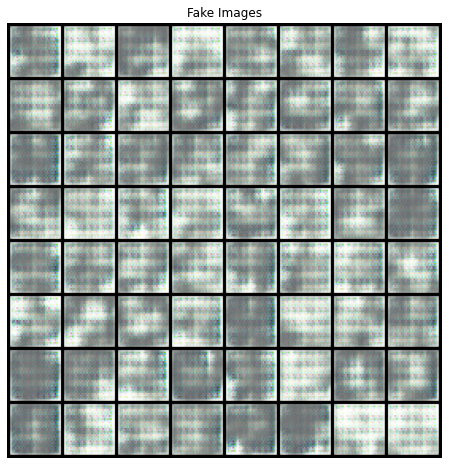

time (s):  12.009641885757446
[91/480][0/11]	Loss_D: 1.3495	Loss_G: 0.6380	D(x): 0.6079	D(G(z)): 0.5607 / 0.5338
time (s):  11.751492261886597
[92/480][0/11]	Loss_D: 1.3334	Loss_G: 0.6727	D(x): 0.5411	D(G(z)): 0.5095 / 0.5115
time (s):  11.754584789276123
[93/480][0/11]	Loss_D: 1.4109	Loss_G: 0.7995	D(x): 0.4783	D(G(z)): 0.4821 / 0.4525
time (s):  11.731368064880371
[94/480][0/11]	Loss_D: 1.3803	Loss_G: 0.6560	D(x): 0.5800	D(G(z)): 0.5617 / 0.5201
time (s):  11.824387073516846
[95/480][0/11]	Loss_D: 1.3673	Loss_G: 0.7213	D(x): 0.5723	D(G(z)): 0.5516 / 0.4874
time (s):  11.811219692230225
[96/480][0/11]	Loss_D: 1.4253	Loss_G: 0.7033	D(x): 0.5369	D(G(z)): 0.5429 / 0.4978
time (s):  11.81771469116211
[97/480][0/11]	Loss_D: 1.3714	Loss_G: 0.7844	D(x): 0.5107	D(G(z)): 0.4991 / 0.4583
time (s):  11.741747617721558
[98/480][0/11]	Loss_D: 1.3384	Loss_G: 0.7207	D(x): 0.5449	D(G(z)): 0.5103 / 0.4907
time (s):  11.796881914138794
[99/480][0/11]	Loss_D: 1.3388	Loss_G: 0.6591	D(x): 0.5814	D(G(z)): 

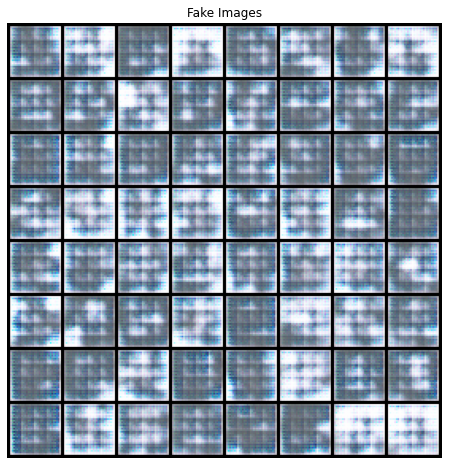

time (s):  12.056818962097168
[137/480][0/11]	Loss_D: 1.1378	Loss_G: 0.9045	D(x): 0.5448	D(G(z)): 0.3971 / 0.4089
time (s):  11.781966924667358
[138/480][0/11]	Loss_D: 1.5459	Loss_G: 0.5882	D(x): 0.4994	D(G(z)): 0.5604 / 0.5560
time (s):  11.747937440872192
[139/480][0/11]	Loss_D: 1.2931	Loss_G: 0.7110	D(x): 0.5653	D(G(z)): 0.5093 / 0.4930
time (s):  11.829329252243042
[140/480][0/11]	Loss_D: 1.4062	Loss_G: 0.7659	D(x): 0.5280	D(G(z)): 0.5210 / 0.4680
time (s):  11.920073986053467
[141/480][0/11]	Loss_D: 1.2704	Loss_G: 0.6523	D(x): 0.6200	D(G(z)): 0.5438 / 0.5216
time (s):  11.778294563293457
[142/480][0/11]	Loss_D: 1.1925	Loss_G: 0.7493	D(x): 0.6034	D(G(z)): 0.4873 / 0.4743
time (s):  11.779014825820923
[143/480][0/11]	Loss_D: 1.4368	Loss_G: 0.5658	D(x): 0.5801	D(G(z)): 0.5857 / 0.5692
time (s):  11.886803388595581
[144/480][0/11]	Loss_D: 1.2585	Loss_G: 0.8703	D(x): 0.5338	D(G(z)): 0.4416 / 0.4214
time (s):  11.804052352905273
[145/480][0/11]	Loss_D: 1.1075	Loss_G: 0.8157	D(x): 0.7008

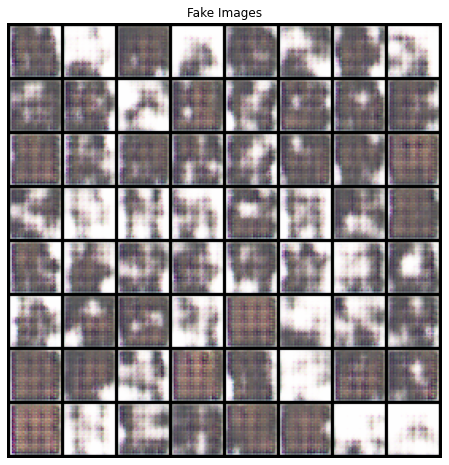

time (s):  12.081461191177368
[182/480][0/11]	Loss_D: 1.3933	Loss_G: 0.8073	D(x): 0.5813	D(G(z)): 0.5654 / 0.4511
time (s):  11.902060747146606
[183/480][0/11]	Loss_D: 1.3258	Loss_G: 0.6776	D(x): 0.5289	D(G(z)): 0.4940 / 0.5091
time (s):  12.051124811172485
[184/480][0/11]	Loss_D: 1.3417	Loss_G: 0.7417	D(x): 0.6128	D(G(z)): 0.5627 / 0.4786
time (s):  12.082116603851318
[185/480][0/11]	Loss_D: 1.2828	Loss_G: 0.6905	D(x): 0.5363	D(G(z)): 0.4789 / 0.5064
time (s):  11.838454723358154
[186/480][0/11]	Loss_D: 1.3684	Loss_G: 0.7768	D(x): 0.5406	D(G(z)): 0.5170 / 0.4700
time (s):  11.844841241836548
[187/480][0/11]	Loss_D: 1.3948	Loss_G: 0.6133	D(x): 0.5089	D(G(z)): 0.5070 / 0.5429
time (s):  11.859586238861084
[188/480][0/11]	Loss_D: 1.2806	Loss_G: 0.7574	D(x): 0.5383	D(G(z)): 0.4749 / 0.4713
time (s):  11.849343538284302
[189/480][0/11]	Loss_D: 1.3433	Loss_G: 0.6238	D(x): 0.5761	D(G(z)): 0.5394 / 0.5397
time (s):  12.010626792907715
[190/480][0/11]	Loss_D: 1.3347	Loss_G: 0.6594	D(x): 0.5182

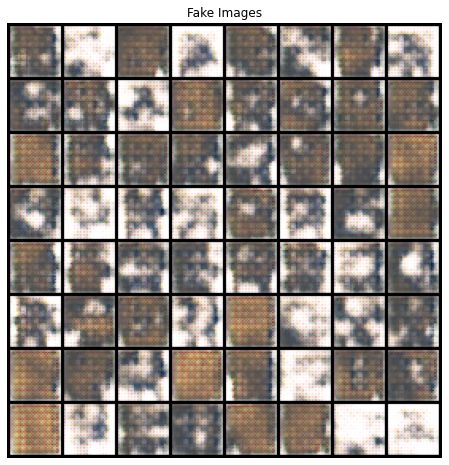

time (s):  11.973726749420166
[228/480][0/11]	Loss_D: 1.3457	Loss_G: 0.7022	D(x): 0.5617	D(G(z)): 0.5262 / 0.4986
time (s):  11.745566129684448
[229/480][0/11]	Loss_D: 1.3110	Loss_G: 0.6850	D(x): 0.5481	D(G(z)): 0.4977 / 0.5088
time (s):  11.764168739318848
[230/480][0/11]	Loss_D: 1.3589	Loss_G: 0.5865	D(x): 0.5809	D(G(z)): 0.5527 / 0.5579
time (s):  12.082009315490723
[231/480][0/11]	Loss_D: 1.2567	Loss_G: 0.8209	D(x): 0.5380	D(G(z)): 0.4664 / 0.4417
time (s):  11.898198127746582
[232/480][0/11]	Loss_D: 1.3572	Loss_G: 0.6402	D(x): 0.5749	D(G(z)): 0.5485 / 0.5287
time (s):  11.756576299667358
[233/480][0/11]	Loss_D: 1.3341	Loss_G: 0.7242	D(x): 0.5260	D(G(z)): 0.4927 / 0.4875
time (s):  11.734469890594482
[234/480][0/11]	Loss_D: 1.3023	Loss_G: 0.7638	D(x): 0.5624	D(G(z)): 0.5097 / 0.4696
time (s):  11.796350240707397
[235/480][0/11]	Loss_D: 1.2404	Loss_G: 0.8291	D(x): 0.5800	D(G(z)): 0.4923 / 0.4408
time (s):  11.841024398803711
[236/480][0/11]	Loss_D: 1.3001	Loss_G: 0.7475	D(x): 0.6023

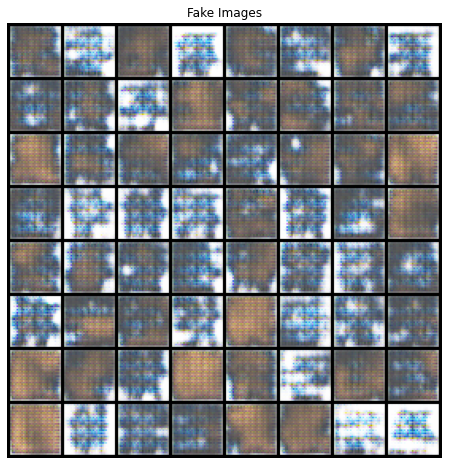

time (s):  12.131599426269531
[273/480][0/11]	Loss_D: 1.2249	Loss_G: 0.7897	D(x): 0.6350	D(G(z)): 0.5244 / 0.4706
time (s):  11.778663158416748
[274/480][0/11]	Loss_D: 1.2751	Loss_G: 0.7182	D(x): 0.5594	D(G(z)): 0.4856 / 0.4952
time (s):  11.824566125869751
[275/480][0/11]	Loss_D: 1.2466	Loss_G: 0.6474	D(x): 0.6553	D(G(z)): 0.5548 / 0.5268
time (s):  11.86173415184021
[276/480][0/11]	Loss_D: 1.2713	Loss_G: 0.6913	D(x): 0.6262	D(G(z)): 0.5482 / 0.5022
time (s):  11.748855113983154
[277/480][0/11]	Loss_D: 1.2516	Loss_G: 0.6451	D(x): 0.5714	D(G(z)): 0.4916 / 0.5276
time (s):  11.775139331817627
[278/480][0/11]	Loss_D: 1.2703	Loss_G: 0.6262	D(x): 0.6041	D(G(z)): 0.5212 / 0.5397
time (s):  11.831266164779663
[279/480][0/11]	Loss_D: 1.1969	Loss_G: 0.7778	D(x): 0.6111	D(G(z)): 0.4938 / 0.4625
time (s):  11.842722415924072
[280/480][0/11]	Loss_D: 1.2389	Loss_G: 0.7123	D(x): 0.6375	D(G(z)): 0.5327 / 0.4978
time (s):  11.804573059082031
[281/480][0/11]	Loss_D: 1.2648	Loss_G: 0.6863	D(x): 0.6073	

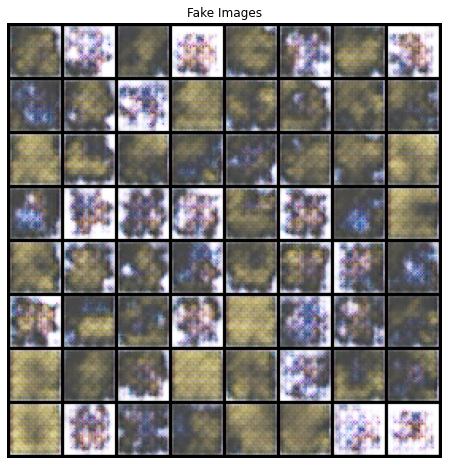

time (s):  12.073999404907227
[319/480][0/11]	Loss_D: 1.2591	Loss_G: 0.6981	D(x): 0.6125	D(G(z)): 0.5280 / 0.5016
time (s):  12.009684324264526
[320/480][0/11]	Loss_D: 1.2702	Loss_G: 0.6597	D(x): 0.5546	D(G(z)): 0.4825 / 0.5200
time (s):  11.866523027420044
[321/480][0/11]	Loss_D: 1.2158	Loss_G: 0.6735	D(x): 0.6457	D(G(z)): 0.5310 / 0.5128
time (s):  11.89661431312561
[322/480][0/11]	Loss_D: 1.2333	Loss_G: 0.6837	D(x): 0.6565	D(G(z)): 0.5433 / 0.5095
time (s):  11.834877967834473
[323/480][0/11]	Loss_D: 1.2736	Loss_G: 0.6822	D(x): 0.6315	D(G(z)): 0.5480 / 0.5078
time (s):  11.870580196380615
[324/480][0/11]	Loss_D: 1.2161	Loss_G: 0.7407	D(x): 0.6835	D(G(z)): 0.5566 / 0.4805
time (s):  11.832512140274048
[325/480][0/11]	Loss_D: 1.3682	Loss_G: 0.6608	D(x): 0.5765	D(G(z)): 0.5424 / 0.5226
time (s):  11.862697839736938
[326/480][0/11]	Loss_D: 1.2595	Loss_G: 0.6991	D(x): 0.6140	D(G(z)): 0.5259 / 0.5000
time (s):  12.074105739593506
[327/480][0/11]	Loss_D: 1.2696	Loss_G: 0.8443	D(x): 0.5875	

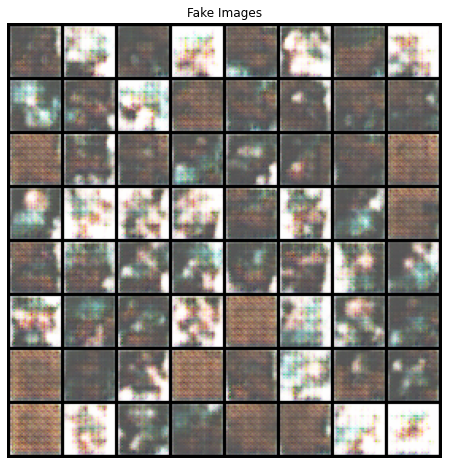

time (s):  12.369523286819458
[364/480][0/11]	Loss_D: 1.2325	Loss_G: 0.6736	D(x): 0.6129	D(G(z)): 0.5137 / 0.5129
time (s):  12.04394245147705
[365/480][0/11]	Loss_D: 1.1981	Loss_G: 0.6550	D(x): 0.6787	D(G(z)): 0.5433 / 0.5234
time (s):  12.142815828323364
[366/480][0/11]	Loss_D: 1.2401	Loss_G: 0.7343	D(x): 0.6714	D(G(z)): 0.5476 / 0.4857
time (s):  12.308074712753296
[367/480][0/11]	Loss_D: 1.1014	Loss_G: 0.7902	D(x): 0.6423	D(G(z)): 0.4689 / 0.4609
time (s):  12.228600978851318
[368/480][0/11]	Loss_D: 1.3463	Loss_G: 0.6308	D(x): 0.5053	D(G(z)): 0.4551 / 0.5381
time (s):  12.144826173782349
[369/480][0/11]	Loss_D: 1.4108	Loss_G: 0.8393	D(x): 0.5680	D(G(z)): 0.5472 / 0.4405
time (s):  12.091366052627563
[370/480][0/11]	Loss_D: 1.0241	Loss_G: 1.2361	D(x): 0.6599	D(G(z)): 0.4202 / 0.3108
time (s):  12.145255327224731
[371/480][0/11]	Loss_D: 1.2268	Loss_G: 0.8564	D(x): 0.7955	D(G(z)): 0.5884 / 0.4412
time (s):  12.275014877319336
[372/480][0/11]	Loss_D: 1.3142	Loss_G: 0.7234	D(x): 0.5872	

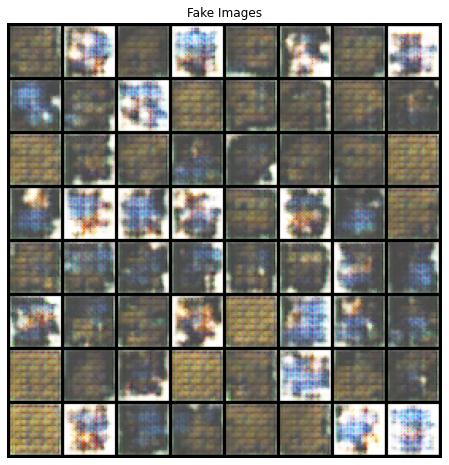

time (s):  12.403604984283447
[410/480][0/11]	Loss_D: 1.2483	Loss_G: 0.6306	D(x): 0.5735	D(G(z)): 0.4837 / 0.5377
time (s):  12.185738801956177
[411/480][0/11]	Loss_D: 1.2104	Loss_G: 0.6825	D(x): 0.6578	D(G(z)): 0.5340 / 0.5108
time (s):  12.376190423965454
[412/480][0/11]	Loss_D: 1.2329	Loss_G: 0.7247	D(x): 0.5959	D(G(z)): 0.4926 / 0.4908
time (s):  12.248236894607544
[413/480][0/11]	Loss_D: 1.3001	Loss_G: 0.7563	D(x): 0.5970	D(G(z)): 0.5206 / 0.4788
time (s):  11.984985113143921
[414/480][0/11]	Loss_D: 1.2492	Loss_G: 0.8639	D(x): 0.6253	D(G(z)): 0.5262 / 0.4342
time (s):  12.020907163619995
[415/480][0/11]	Loss_D: 1.2363	Loss_G: 0.6483	D(x): 0.6983	D(G(z)): 0.5691 / 0.5281
time (s):  11.926311016082764
[416/480][0/11]	Loss_D: 1.2643	Loss_G: 0.7965	D(x): 0.5840	D(G(z)): 0.4933 / 0.4559
time (s):  12.031641483306885
[417/480][0/11]	Loss_D: 1.2551	Loss_G: 0.7389	D(x): 0.6553	D(G(z)): 0.5477 / 0.4867
time (s):  12.032953262329102
[418/480][0/11]	Loss_D: 1.2491	Loss_G: 0.7086	D(x): 0.6467

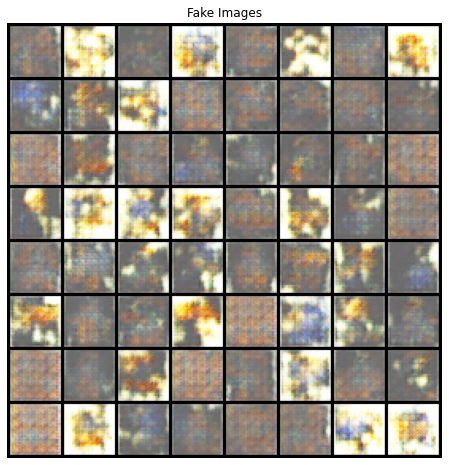

time (s):  12.183148622512817
[455/480][0/11]	Loss_D: 1.3669	Loss_G: 0.6950	D(x): 0.6382	D(G(z)): 0.5723 / 0.5054
time (s):  11.877463102340698
[456/480][0/11]	Loss_D: 1.1559	Loss_G: 0.8390	D(x): 0.6223	D(G(z)): 0.4722 / 0.4485
time (s):  11.908422708511353
[457/480][0/11]	Loss_D: 1.3335	Loss_G: 0.6944	D(x): 0.6791	D(G(z)): 0.5978 / 0.5068
time (s):  11.969654560089111
[458/480][0/11]	Loss_D: 1.2437	Loss_G: 0.7331	D(x): 0.6153	D(G(z)): 0.5162 / 0.4874
time (s):  12.162848949432373
[459/480][0/11]	Loss_D: 1.2496	Loss_G: 0.7612	D(x): 0.6259	D(G(z)): 0.5290 / 0.4728
time (s):  12.303098917007446
[460/480][0/11]	Loss_D: 1.1946	Loss_G: 0.7723	D(x): 0.6299	D(G(z)): 0.5012 / 0.4721
time (s):  12.07989501953125
[461/480][0/11]	Loss_D: 1.1677	Loss_G: 0.7155	D(x): 0.6832	D(G(z)): 0.5297 / 0.4954
time (s):  12.111415386199951
[462/480][0/11]	Loss_D: 1.3372	Loss_G: 0.6951	D(x): 0.6165	D(G(z)): 0.5567 / 0.5058
time (s):  12.045694351196289
[463/480][0/11]	Loss_D: 1.2315	Loss_G: 0.7273	D(x): 0.5736	

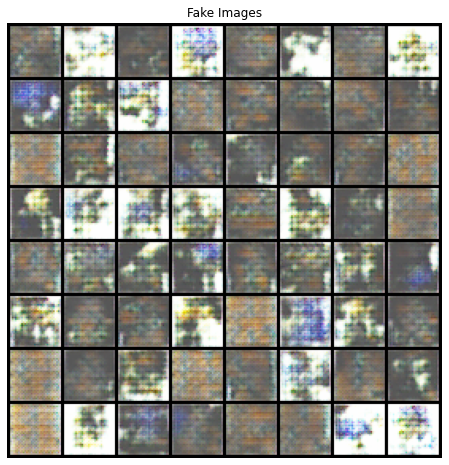

time (s):  12.348847150802612
CPU times: user 1h 34min 4s, sys: 1min 24s, total: 1h 35min 28s
Wall time: 1h 35min 39s


In [0]:
%%time

import time

model_path = "/content/drive/My Drive/Colab Notebooks/CMSC498L"

# load model
# model = TheModelClass(*args, **kwargs)
# model.load_state_dict(torch.load(PATH))
# model.eval()

best_loss = np.inf

# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

summary_writer = SummaryWriter(log_dir="tb_log/{}".format(model_name if len(model_name) else None ))

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    start = time.time()
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            summary_writer.add_scalar("loss/D",errD.item(), epoch*821 + i) # add train loss to tensorboard
            summary_writer.add_scalar("loss/G",errG.item(), epoch*821 + i) # add train loss to tensorboard


        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            # Plot the fake images from the last epoch
            plt.figure(figsize=(8,8))
            plt.axis("off")
            plt.title("Fake Images")
            plt.imshow(np.transpose(img_list[-1],(1,2,0)))
            plt.show()
            
        iters += 1

    print("time (s): ",time.time()-start)
    # save models
    torch.save(netD.state_dict(), model_path + model_name)
    torch.save(netG.state_dict(), model_path + model_name)


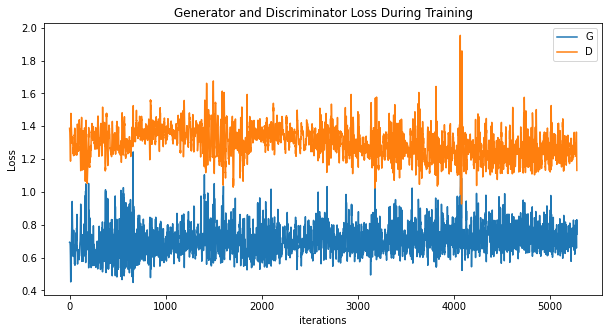

In [0]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

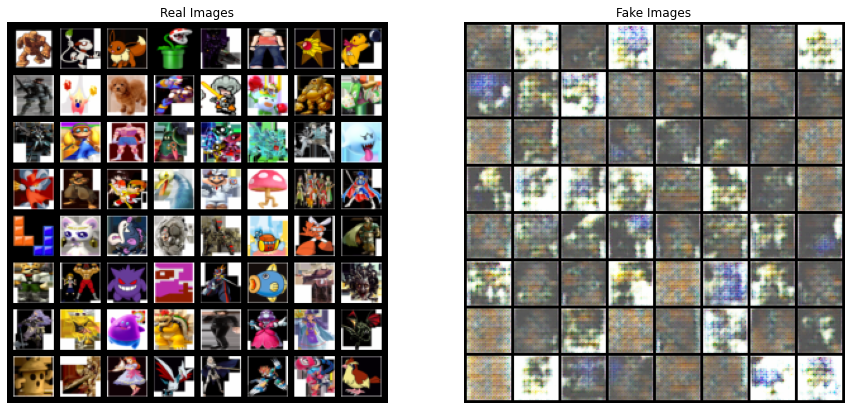

In [0]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

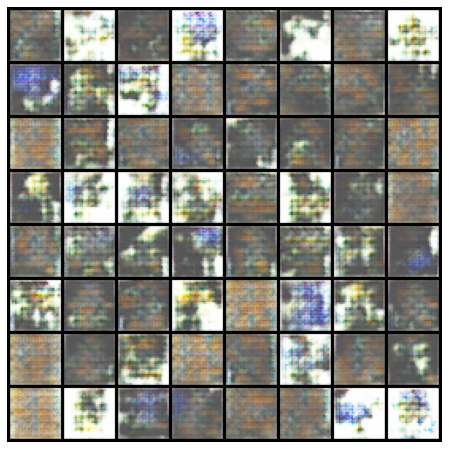

In [0]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())